In [14]:
import numpy as np
import imageio
from skimage.color import rgb2hsv, hsv2rgb
import sys
import matplotlib.pyplot as plt

# Code

In [15]:
def setup_progressbar(bar_width=50):
    # setup progressbar
    sys.stdout.write("[%s]" % (" " * bar_width))
    sys.stdout.flush()
    # return to start of line, after '['
    sys.stdout.write("\b" * (bar_width+1))


def update_progressbar(n, i, bar_width=50):
    # updates the bar considering the porcentage of work done,
    # n being the size of the problem and i the actual iteration.

    if (n < bar_width):
        sys.stdout.write("%s" % ('-'*(bar_width//n)))
        sys.stdout.flush()
    elif (i % (round((1.0/bar_width)*n)) == 0):
        sys.stdout.write("-")
        sys.stdout.flush()


def finish_progressbar():
    sys.stdout.write("]\n")  # this ends the progress bar

In [16]:
def normalize_image(img, new_min=0, new_max=255):
    """ returns an image with its values normalized between [new_min:new_max] """

    old_min = np.amin(img)
    old_max = np.amax(img)

    return new_min + (((img - old_min) * (new_max - new_min)) / (old_max - old_min))

In [17]:
def downscale(img, n, m):
    """ Takes an image by input and downscales it to the desired resolution (n, m) 
        The downscale is done by aquiring the mean value of a region, so it can be represented by only one value
    """

    out_img = np.zeros((n, m, 3))
    xi, yi = img.shape[0:2]

    if n > xi or m > yi:
        print("Error: Desired resolution larger than original. Downscale not possible.")
        return out_img

    x_factor = xi // n
    y_factor = yi // m

    # get the pixels of the output image
    for x in range(n):
        for y in range(m):
            i = x_factor * x
            j = y_factor * y

            frame = img[i:i+x_factor, j:j+y_factor]
            out_img[x, y, 0] = frame[:, :, 0].sum() / (x_factor * y_factor)
            out_img[x, y, 1] = frame[:, :, 1].sum() / (x_factor * y_factor)
            out_img[x, y, 2] = frame[:, :, 2].sum() / (x_factor * y_factor)

    return out_img

In [18]:
def fix_division(xi, xf, axis_size):
    """ Aux function used in the mosaic division function,

        it make sure that the created division cover at least 1 pixel and does not surpasses the axis size
    """
    xi, xf = np.clip([xi, xf], 0, axis_size)

    if(xf-xi <= 1):
        xi -= 1
        xf += 1

    return np.clip([xi, xf], 0, axis_size)

In [19]:
def find_division(divisions, xi, xf, yi, yf, n_imgs):
    """ Aux function used in the mosaic division function,

        This function maps all needed divisions in a list,
        it search a division defined by [xf-xi, yf-yi] in the list divisions and return it's index
        if the division doesn't exist, it will be created and have a tile image index associated to it
    """
    e = [xf - xi, yf - yi]  # division dimension that define an unique division

    found = False
    i = 0  # image index used to search the list
    img = 0  # true image index to be returned
    while(i < n_imgs and not found):
        if e+[i] in divisions:
            found = True
            img = i
        i += 1

    if not found:
        img = np.random.randint(0, n_imgs)
        divisions.append(e+[img])

    return divisions.index(e+[img])

In [20]:
def create_division_dist(n_elem=100, n_div=10, mean=100, std=25, fix_black=0, axis_size=1000):
    """ Aux function used in the random mosaic division,

        it generates elements in the normal distributon that define the shapes in the mosaic
        parameters:
            n_elem: amount of elements that will represent all the divisions done in the axis (resolution in the axis)
            n_div: max amount of unique elements in the distribution, so it can reduce the unique divisions
            mean, std: mean and standard deviation of the normal distribution
            fix_black: flag to calculate the numeric error, it generates more unique division when equals 1 
            axis_size: size of the axis that the distribution represents, needed when fix_black = 1 
    """
    rand_x = np.abs(np.random.normal(loc=mean, scale=std,
                                     size=n_div))  # unique proportions

    u = np.zeros((n_elem))  # divisions proportions that cover the axis
    # fill the vectors that will define the mosaic division
    for i in range(n_elem):
        u[i] = rand_x[np.random.randint(0, n_div)]

    # normalize the vectors, so it represents the proportion that each tile occupies in the mosaic
    u = u / np.sum(u)

    # possible black border fix
    if (fix_black == 1):  # add the numeric error to the last element, so it can cover all pixels in the image
        missing_x = axis_size - \
            (np.sum((u*axis_size).astype(np.int)))  # numeric error
        u[-1] += missing_x / axis_size

    return u

In [21]:
def create_mosaic_division(x, y, n_imgs=1, resolution=(50, 50), method=1, rand_parameters=(10, 10, 100, 25), fix_black=1):
    """ return an array of index that define a mosaic composition to overlay the image 
    
        input:
            x, y: shape of the image that will be represented as a mosaic.
            n_imgs: number of tile images that will compose the mosaic.
            resolution: amount of tiles in the (x,y) dimensions that will compose the mosaic.
            method: 1 - divides the image into equal sized rectangles;
                    2 - creates a random mosaic -- low amount of unique division, faster algorithm;
                    3 - creates a random mosaic with a more varied y dimension -- medium amount of unique divions;
                    4 - creates a random mosaic with more unique division in x and y dimensions -- high amount of unique divisions.
            rand_parameters: parameters that will be used in the random creation of the mosaic, depending on the method.
                    rand_parameters[0]: number of different shapes that can occur in the x dimension;
                    rand_parameters[1]: number of different shapes that can occur in the y dimension;
                    rand_parameters[2]: the normal distribution's mean, which will be used in the creation of the mosaic shapes;
                    rand_parameters[3]: the normal distribution's standard deviation.
                            
        return:
            mosaic: array of lists defining the subimages' ranges                           
            divisions: array of lists defining the sizes and images that each tile will use 
            # mosaic[i] = [xi, xf, yi, yf, d=division_index]
            # divisions[i] = [x_size=xf-xi, y_size=yf-yi, e=image_index]

    """

    # mosaic[i] = [xi, xf, yi, yf, d=division_index]
    mosaic = []
    # divisions[i] = [x_size=xf-xi, y_size=yf-yi, e=image_index]
    divisions = []

    # ******************* Method 1 *******************
    if method == 1:
        # divides the image in rectagles of the same size
        n = x // resolution[0]
        m = y // resolution[1]

        # number of pixels missing in the x and y dimension because of integer division
        missing_x = 0
        missing_y = 0
        if fix_black == 1:
            missing_x = round(
                ((x/resolution[0]) - (x//resolution[0])) * resolution[0])
            missing_y = round(
                ((y/resolution[1]) - (y//resolution[1])) * resolution[1])

        offset_x = 0
        for i in range(resolution[0]):
            xi = i*n + offset_x
            if i < missing_x:
                offset_x += 1

            xf = (i+1)*n + offset_x

            offset_y = 0
            for j in range(resolution[1]):
                yi = j*m + offset_y
                if j < missing_y:
                    offset_y += 1
                yf = (j+1)*m + offset_y

                d = find_division(divisions, xi, xf, yi, yf, n_imgs)
                mosaic.append([xi, xf, yi, yf, d])

    # ******************* Method 2/3 *******************
    elif method == 2 or method == 3:
        # creates a random mosaic in the x and y dimension, while mantaining the desired resolution

        # Creates only one distribution to define the rows, so all tiles will have the same height in a given row
        u = create_division_dist(n_elem=resolution[0], n_div=rand_parameters[0], mean=rand_parameters[2],
                                 std=rand_parameters[3], fix_black=fix_black, axis_size=x)
        if method == 2:
            # Creates only one distribution to define the columns, so all tiles will have the same width in a given column
            v = create_division_dist(n_elem=resolution[1], n_div=rand_parameters[1], mean=rand_parameters[2],
                                     std=rand_parameters[3], fix_black=fix_black, axis_size=y)

        # fill the mosaic divison
        last_x = 0
        for i in range(resolution[0]):
            xi = last_x
            xf = int(round(u[i]*x + xi))
            xi, xf = fix_division(xi, xf, x)
            last_x = xf

            if method == 3:
                # Creates various distribution defining the columns, so all tiles have diferents widths in all columns
                v = create_division_dist(n_elem=resolution[1], n_div=rand_parameters[1], mean=rand_parameters[2],
                                         std=rand_parameters[3], fix_black=fix_black, axis_size=y)

            last_y = 0
            for j in range(resolution[1]):
                yi = last_y
                yf = int(round(v[j]*y + yi))
                yi, yf = fix_division(yi, yf, y)
                last_y = yf

                d = find_division(divisions, xi, xf, yi, yf, n_imgs)
                mosaic.append([xi, xf, yi, yf, d])

    # ******************* Method 4 *******************
    elif method == 4:
        # creates a more random mosaic in the x and y dimension, while mantaining the desired resolution
        # note that this method may create roles in the final mosaic

        # Creates various distribution defining the columns, so all tiles have diferents widths in all columns
        for i in range(resolution[0]):
            v = create_division_dist(n_elem=resolution[1], n_div=rand_parameters[1],
                                     mean=rand_parameters[2], std=rand_parameters[3], fix_black=fix_black, axis_size=y)
            last_y = 0
            for j in range(resolution[1]):
                yi = last_y
                yf = int(round(v[j]*y + yi))
                yi, yf = fix_division(yi, yf, y)
                last_y = yf

                # mosaic.append([xi=0, xf=0, yi, yf, d=0])
                mosaic.append([0, 0, yi, yf, 0])

        # Creates various distribution defining the rows, so all tiles have diferents heights in all rows
        # and defines all unique divisions and it index in the divisions list
        for j in range(resolution[1]):
            u = create_division_dist(n_elem=resolution[0], n_div=rand_parameters[0],
                                     mean=rand_parameters[2], std=rand_parameters[3], fix_black=fix_black, axis_size=x)
            last_x = 0
            for i in range(resolution[0]):
                xi = last_x
                xf = int(round(u[i]*x + xi))
                xi, xf = fix_division(xi, xf, x)
                last_x = xf

                yi, yf = mosaic[(i*resolution[1]) + j][2:4]
                # mosaic[(i*resolution[1]) + j] = [xi, xf, yi, yf, 0]
                d = find_division(divisions, xi, xf, yi, yf, n_imgs)
                mosaic[(i*resolution[1]) + j] = [xi, xf, yi, yf, d]

    return mosaic, divisions

In [22]:
def get_predominant_color(img):
    """ Returns the predominant color present in the image and the max and min values
            It defines the predominant color using the mean of all the 3 channels
    """

    color = np.zeros((3))
    max_colors = np.zeros((3))
    min_colors = np.zeros((3))

    max_colors[0] = np.max(img[:, :, 0])
    max_colors[1] = np.max(img[:, :, 1])
    max_colors[2] = np.max(img[:, :, 2])

    min_colors[0] = np.min(img[:, :, 0])
    min_colors[1] = np.min(img[:, :, 1])
    min_colors[2] = np.min(img[:, :, 2])

    # mean of all colors in the image
    color[0] = np.mean(img[:, :, 0])
    color[1] = np.mean(img[:, :, 1])
    color[2] = np.mean(img[:, :, 2])

    return color, min_colors, max_colors

In [23]:
def alter_color(img, predominant_color, min_color, max_color, method=1):
    """ alters the color of the image to approximate it to the predominant_color parameter
        
        inputs:
            img: downscaled tile image.
            predominant_color: the predominant color of a given section of the canvas image (obtained using the mean).
            min_color: the minimum color value of a given section of the canvas image.
            max_color: the maximum color value of a given section of the canvas image.
            method: which color representation method to use in the color processing
                1 - RGB: applies a color balancing in the rgb model, so the tile image color moves to the desired color
                2 - HSV: use the hue and saturation of the desired color to replace these values in the tile image 
                In both methods, a normalization using the max and min intensities of the original image is required, 
                so it can accurately represent the color intensity of the original image.
    """

    out_img = np.array(img, copy=True)

    if method == 1:
        predominant_color = predominant_color / np.sum(predominant_color)
        # changes the color channels proportions to the predominant color proportion
        out_img[:, :, 0] = out_img[:, :, 0] * predominant_color[0]  # R
        out_img[:, :, 1] = out_img[:, :, 1] * predominant_color[1]  # G
        out_img[:, :, 2] = out_img[:, :, 2] * predominant_color[2]  # B

    elif method == 2:
        # transforms to the HSV color representation
        out_img = rgb2hsv(out_img)
        predominant_color = rgb2hsv(np.reshape(predominant_color, (1, 1, 3)))

        out_img[:, :, 0] = (predominant_color[:, :, 0])  # alters hue
        out_img[:, :, 1] = (predominant_color[:, :, 1])  # alters saturation

        out_img = hsv2rgb(out_img)

    # returns to original color interval in rgb to accurately represent the intensity (black/white)
    out_img = normalize_image(out_img, new_min=min_color, new_max=max_color)

    return np.clip(out_img, 0, 255)

In [24]:
def mosaic_transform(canvas_img, tile_imgs, n_imgs=1, resolution=(50, 50), division_method=1,
                     rand_parameters=(10, 10, 100, 25), fix_black=1, alter_color_method=2):
    """ creates a mosaic that represents one image using other images
        
        inputs:
            canvas_img: image to be turned into a mosaic (represented as such).
            tile_imgs: images used as the mosaic's tiles.
            n_imgs: number of tile images that will compose the mosaic.
            resolution: number of tiles to compose the final image in each dimension (x, y)
            division_method: 1 - divides the image into equal sized rectangles;
                             2 - creates a random mosaic -- low amount of unique divisions, faster algorithm;
                             3 - creates a random mosaic with a more varied y dimension -- medium amount of unique divisions;
                             4 - creates a random mosaic with more unique divisions in x and y dimensions -- high amount of unique divisions.
            rand_parameters: parameters that will be used in the random creation of the mosaic, depending on the method.
                    rand_parameters[0]: number of different shapes that can occur in the x dimension;
                    rand_parameters[1]: number of different shapes that can occur in the y dimension;
                    rand_parameters[2]: the gaussians distribution's mean, which will be used in the creation of the mosaic shapes;
                    rand_parameters[3]: the gaussian distribution's standard deviation.
            fix_black: chooses whether the black border will be fixed (1) or not (0).
            alter_color_method: 1 - RGB color processing
                                2 - HSV color processing

        return:
            out_img: the canvas image represented as a mosaic, composed of smaller versions of all tile images.
    """

    out_img = np.zeros(canvas_img.shape)  # creates output image

    print("Creating mosaic...")
    x, y = canvas_img.shape[0:2]
    mosaic, divisions = create_mosaic_division(x, y, n_imgs=n_imgs, resolution=resolution,
                                               method=division_method, rand_parameters=rand_parameters, fix_black=fix_black)

    n_div = len(divisions)
    print("number of unique divison: ", n_div,
          ", total divisions: ", len(mosaic))

    print("Creating tile images...")
    setup_progressbar()
    i = 0

    down_tiles = []
    for division in divisions:
        down_tiles.append(
            downscale(tile_imgs[division[2]], division[0], division[1]))
        i += 1
        update_progressbar(n=n_div, i=i)
    finish_progressbar()

    print("Composing the Mosaic...")
    setup_progressbar()
    i = 0

    for subimage in mosaic:
        xi, xf, yi, yf, d = subimage

        predominant_color, min_color, max_color = get_predominant_color(
            canvas_img[xi:xf, yi:yf])
        tile = alter_color(
            down_tiles[d], predominant_color, min_color, max_color, method=alter_color_method)
        out_img[xi:xf, yi:yf] = tile
        i += 1
        update_progressbar(n=resolution[0]*resolution[1], i=i)
    finish_progressbar()

    return out_img

# Main execution

In [41]:
def quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                ux, uy, mean, std, fix_black, alter_color_method):
    
    # reads image from directory and changes the data type, also it ignores the alpha channel in png format
    canvas_img = imageio.imread('../images/'+img_name_canvas)[:, :, 0:3].astype(np.float)
    tile_imgs = []
    for name in tile_names:
        tile_imgs.append(imageio.imread('../images/'+name)[:, :, 0:3].astype(np.float))

    # creates mosaic
    out_img = mosaic_transform(canvas_img, tile_imgs, n_imgs=n_imgs, resolution=(x, y),
               division_method=division_method,rand_parameters=(ux, uy, mean, std),
               fix_black=fix_black, alter_color_method=alter_color_method)
    out_img = out_img.astype(np.uint8)

    print("Finished.")
    
    return canvas_img.astype(np.uint8), tile_imgs, out_img

# Method 1 example

In [68]:
img_name_canvas = "butterfly.jpg"  # Image to be transformed into mosaic
n_imgs = 1                         # Number of tile images to compose the mosaic
tile_names = ["tile4.jpg"]         # Tile images
x, y = (80, 120)                   # Mosaic resolution -> 80x120 tile images
division_method = 1                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux=0, uy=0, mean=0, std=0, fix_black=fix_black, alter_color_method=alter_color_method)

Creating mosaic...
number of unique divison:  4 , total divisions:  9600
Creating tile images...
[                                                  ------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Tile image')

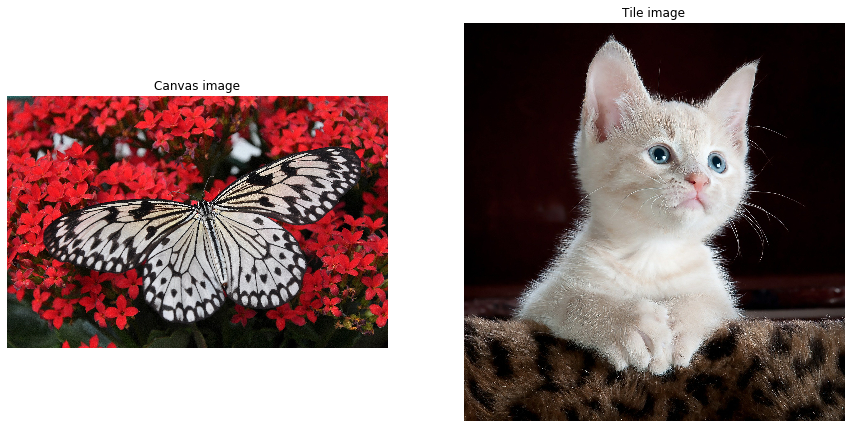

In [69]:
plt.figure(figsize=(15, 15))

plt.subplot(121)
plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

plt.subplot(122)
plt.axis("off")
plt.imshow(tile_imgs[0].astype(np.uint8))
plt.title("Tile image")

Text(0.5, 1.0, 'Mosaic')

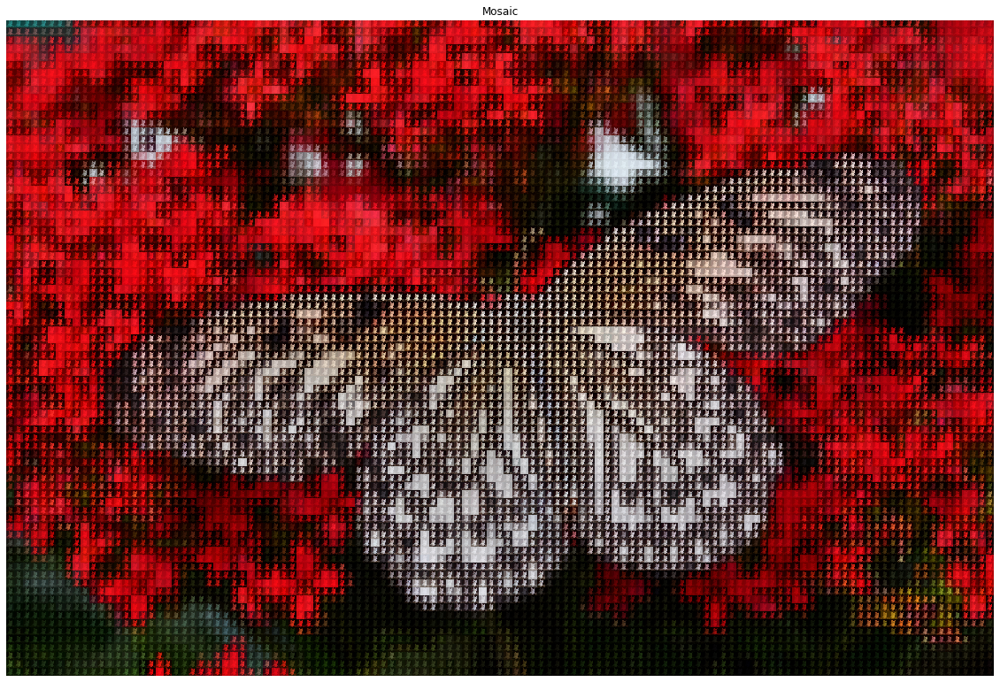

In [70]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

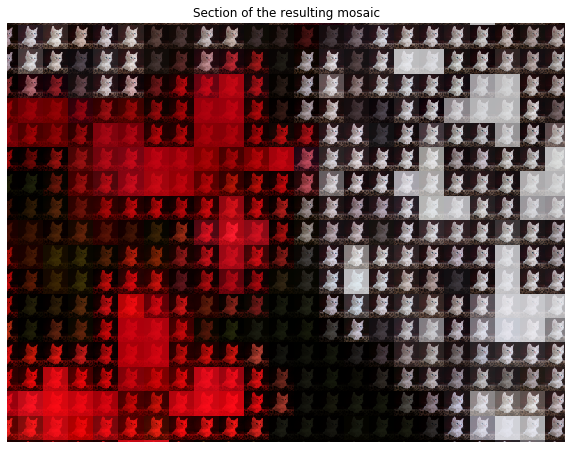

In [71]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(out_img[1900:2501, 1100:1901, :])
plt.title("Section of the resulting mosaic")

# Method 2 example

In [113]:
img_name_canvas = "tartaruga.jpg"  # Image to be transformed into mosaic
n_imgs = 5                         # Number of tile images to compose the mosaic
tile_names = ["tile1.jpg",         # Tile images
              "tile2.jpg",
              "tile3.jpg",
              "tile5.jpg",
              "tile6.jpg"]         
x, y = (50, 75)                    # Mosaic resolution -> 80x120 tile images
division_method = 2                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing
ux = 10
uy = 10
mean = 100
std = 25

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method)

Creating mosaic...
number of unique divison:  80 , total divisions:  3750
Creating tile images...
[                                                  ----------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

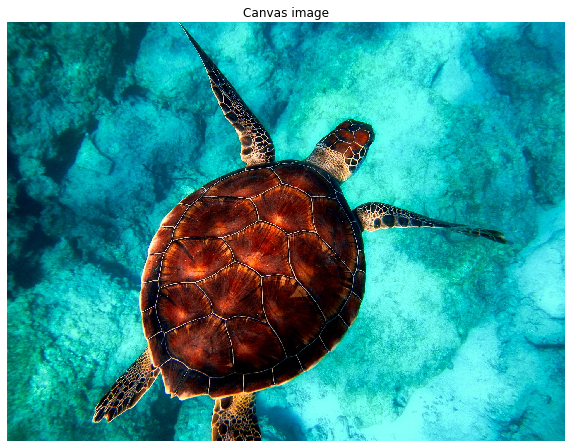

In [91]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 5')

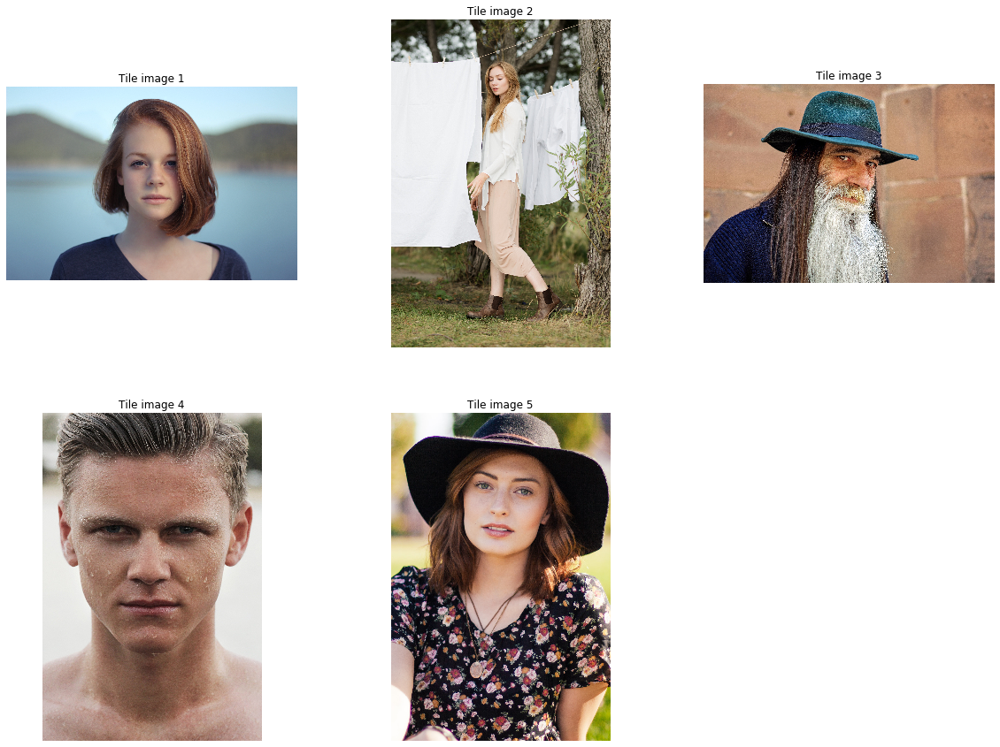

In [101]:
plt.figure(figsize=(20, 15))

plt.subplot(231); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(232); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(233); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(234); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(235); plt.axis("off"); plt.imshow(tile_imgs[4].astype(np.uint8)); plt.title("Tile image 5")

Text(0.5, 1.0, 'Mosaic')

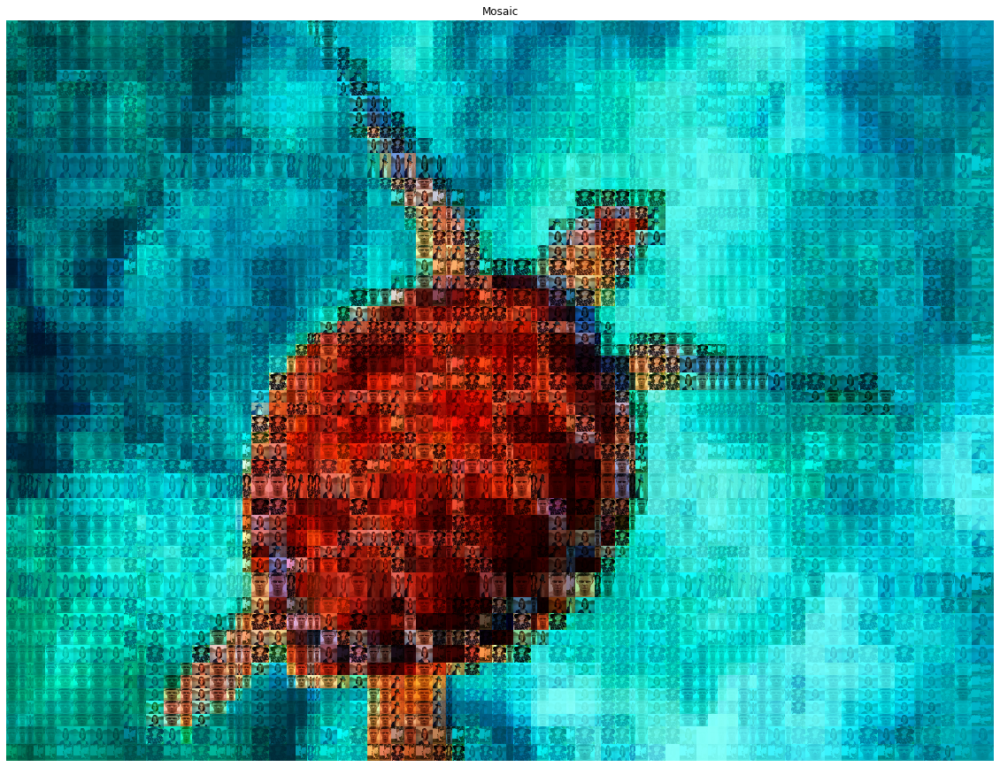

In [114]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

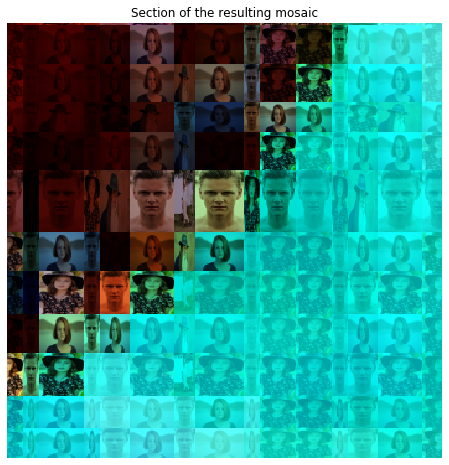

In [117]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1000:1351, 1000:1351, :])
plt.title("Section of the resulting mosaic")

# Method 3 example using HSV

In [118]:
img_name_canvas = "grafitti2.jpg"  # Image to be transformed into mosaic
n_imgs = 3                         # Number of tile images to compose the mosaic
tile_names = ["lapis.jpg",         # Tile images
              "lapis2.jpg",
              "lapis3.png"]         
x, y = (75, 100)                   # Mosaic resolution -> 80x120 tile images
division_method = 3                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 2             # HSV color processing
ux = 15
uy = 15
mean = 100
std = 25

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method)

Creating mosaic...
number of unique divison:  484 , total divisions:  7500
Creating tile images...
[                                                  ------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

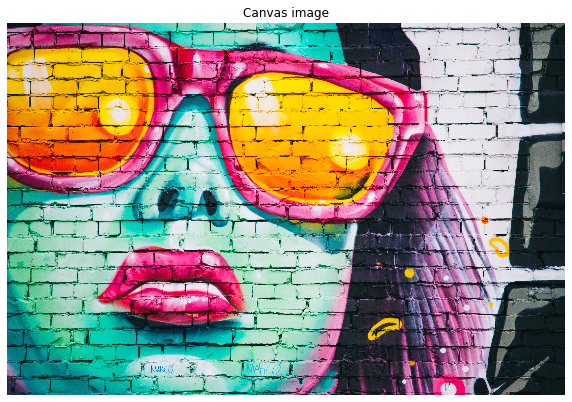

In [119]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 3')

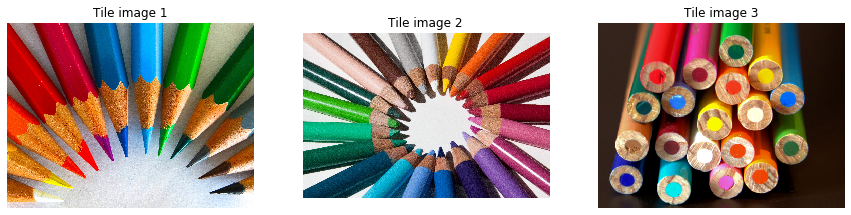

In [109]:
plt.figure(figsize=(15, 10))

plt.subplot(131); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(132); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(133); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")

Text(0.5, 1.0, 'Mosaic')

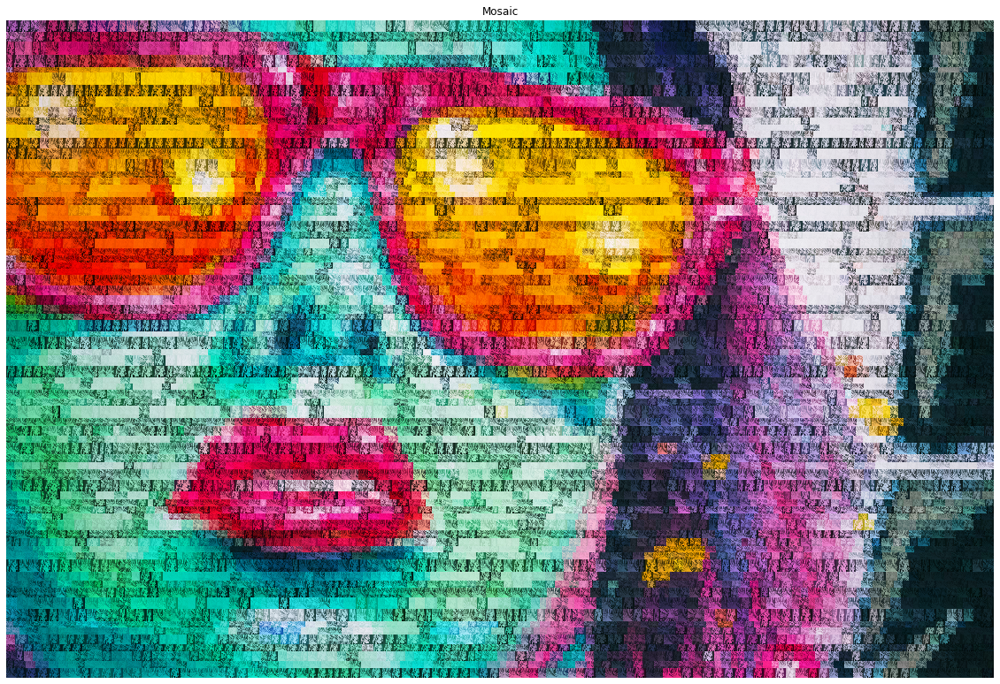

In [120]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

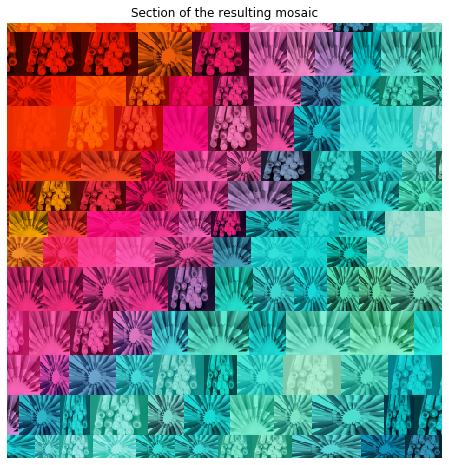

In [122]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1000:1501, 1000:1501, :])
plt.title("Section of the resulting mosaic")

# Method 3 example using RGB

In [140]:
img_name_canvas = "airport.jpg"    # Image to be transformed into mosaic
n_imgs = 4                         # Number of tile images to compose the mosaic
tile_names = ["skydiving.jpg",     # Tile images
              "mammal.jpg",
              "tile7.jpg",
              "tile9.jpg"]         
x, y = (100, 160)                  # Mosaic resolution -> 80x120 tile images
division_method = 3                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing
ux = 10
uy = 10
mean = 100
std = 25

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method)

Creating mosaic...
number of unique divison:  298 , total divisions:  16000
Creating tile images...
[                                                  -------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------

/home/daniel/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide


------]
Finished.


Text(0.5, 1.0, 'Canvas image')

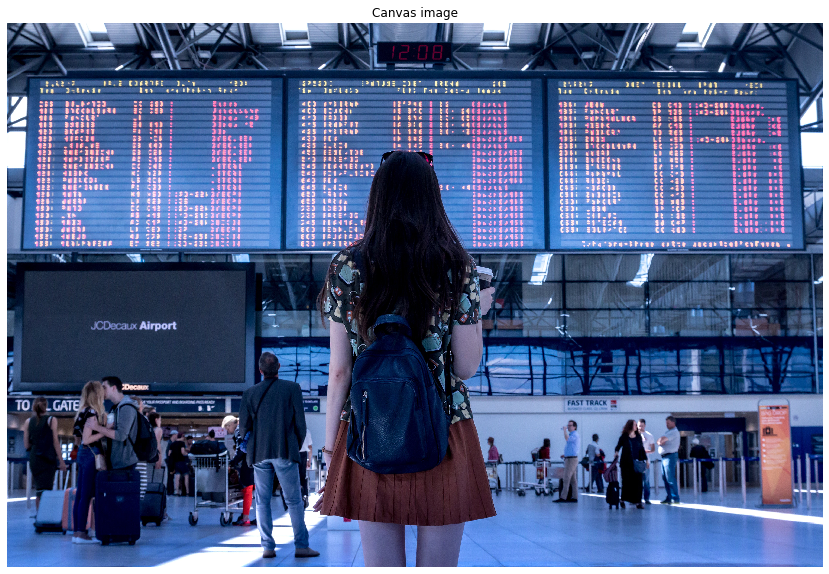

In [126]:
plt.figure(figsize=(16, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 4')

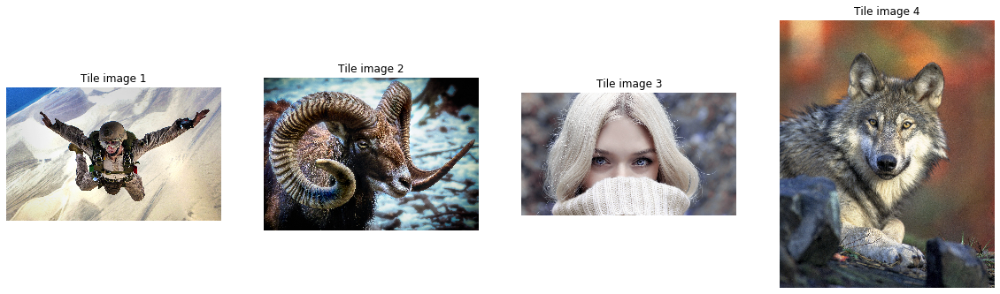

In [129]:
plt.figure(figsize=(20, 15))

plt.subplot(141); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(142); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(143); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(144); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")

Text(0.5, 1.0, 'Mosaic')

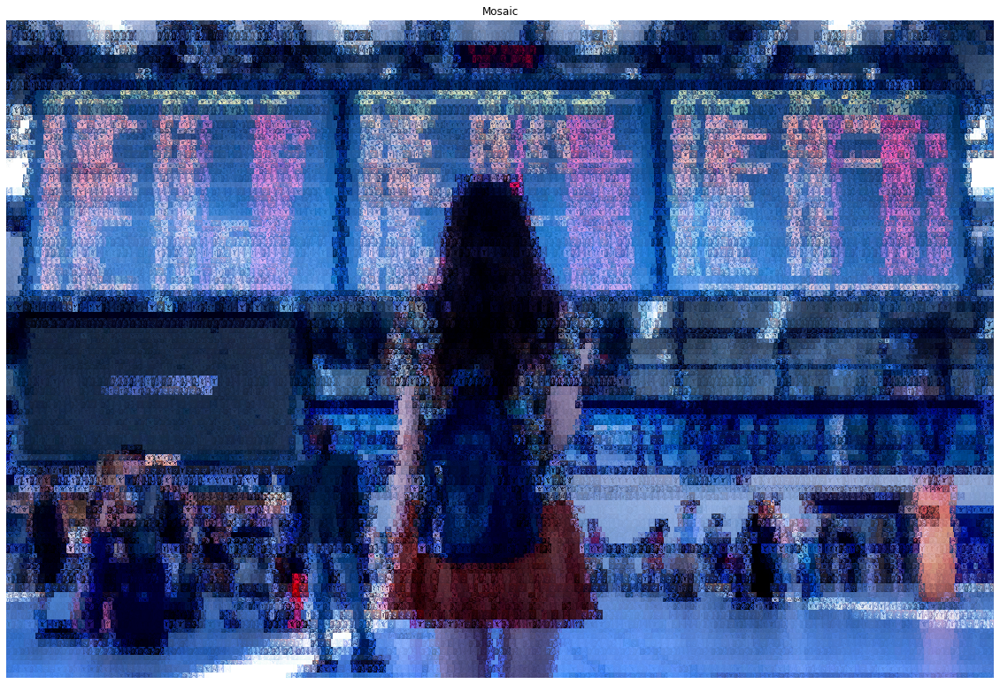

In [141]:
plt.figure(figsize=(20, 16))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

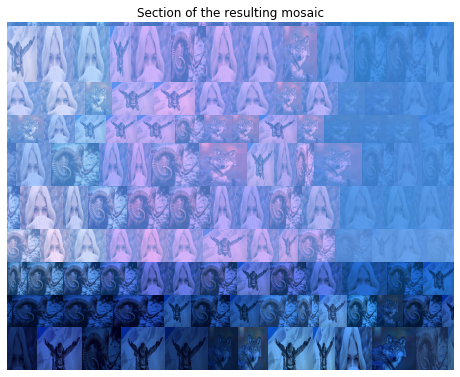

In [144]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1250:1601, 1250:1701, :])
plt.title("Section of the resulting mosaic")

# Method 4 example

In [147]:
img_name_canvas = "arara1.jpg"  # Image to be transformed into mosaic
n_imgs = 6                         # Number of tile images to compose the mosaic
tile_names = ["arara2.jpg",         # Tile images
              "dogs.jpg",
              "tile1.jpg",
              "tile5.jpg",
              "cat.jpg",
              "tile9.jpg"]         
x, y = (75, 100)                   # Mosaic resolution -> 80x120 tile images
division_method = 4                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 2             # HSV color processing
ux = 10
uy = 10
mean = 100
std = 25

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method)

Creating mosaic...
number of unique divison:  2218 , total divisions:  7500
Creating tile images...
[                                                  --------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

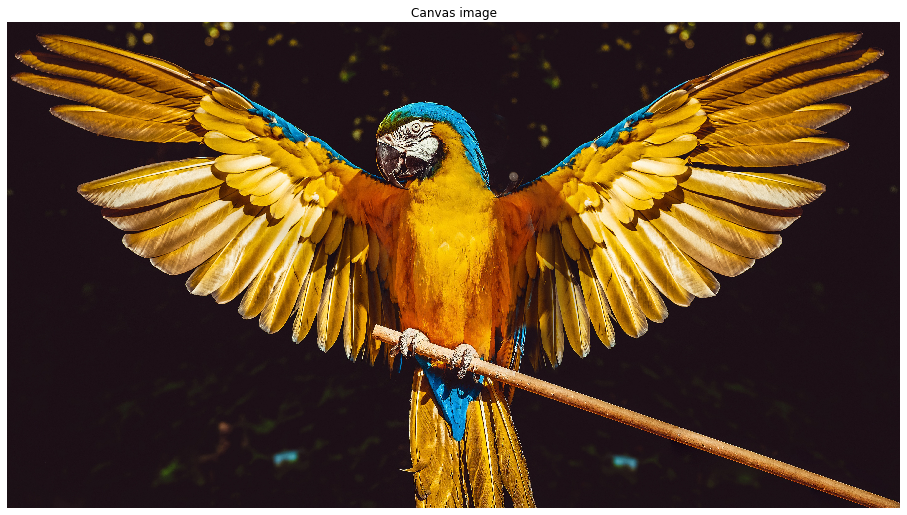

In [148]:
plt.figure(figsize=(16, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 4')

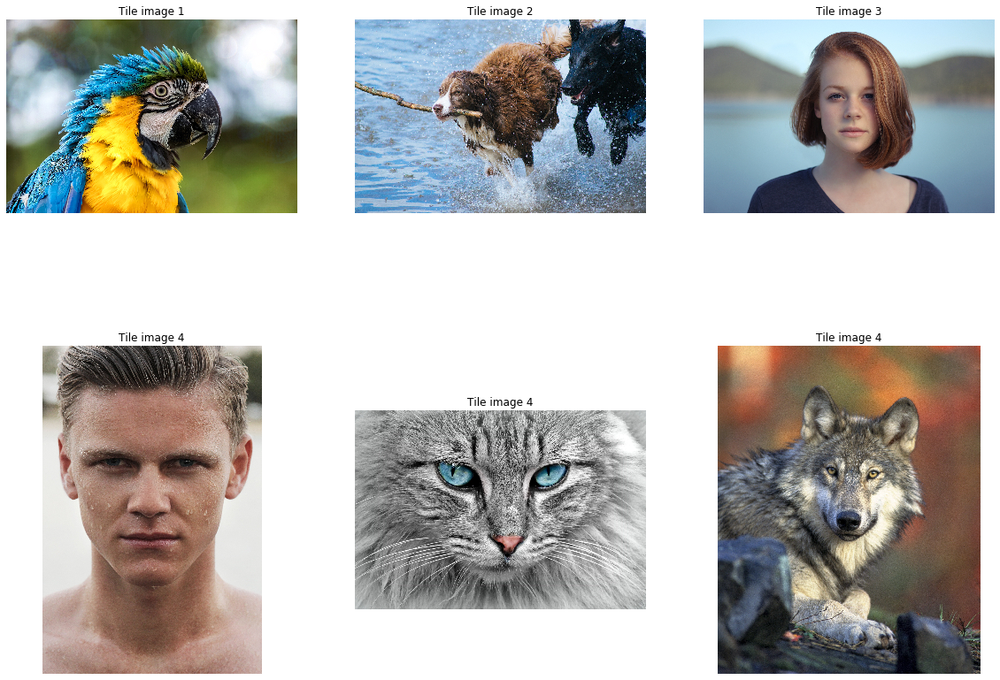

In [149]:
plt.figure(figsize=(20, 15))

plt.subplot(231); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(232); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(233); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(234); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(235); plt.axis("off"); plt.imshow(tile_imgs[4].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(236); plt.axis("off"); plt.imshow(tile_imgs[5].astype(np.uint8)); plt.title("Tile image 4")

Text(0.5, 1.0, 'Mosaic')

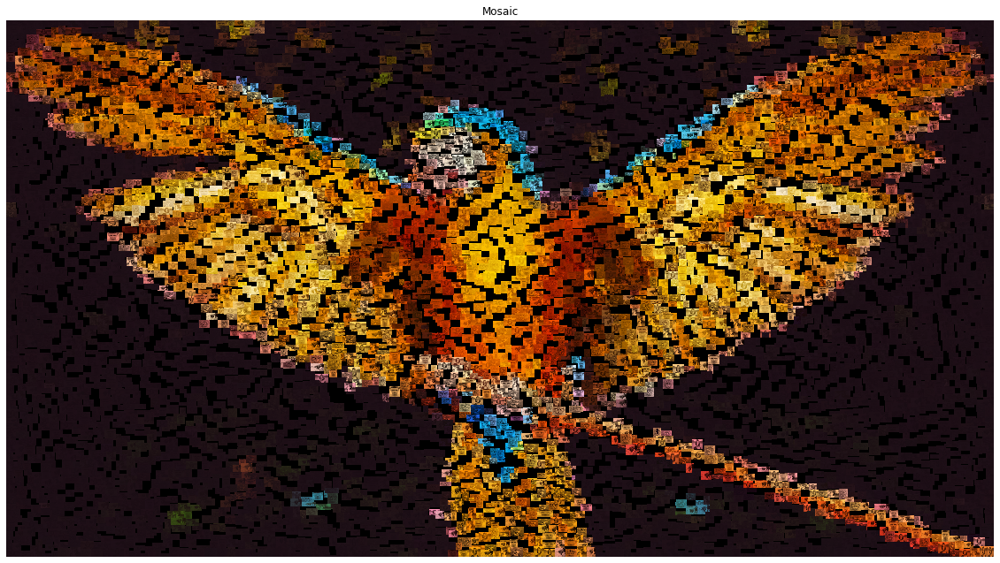

In [150]:
plt.figure(figsize=(20, 16))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

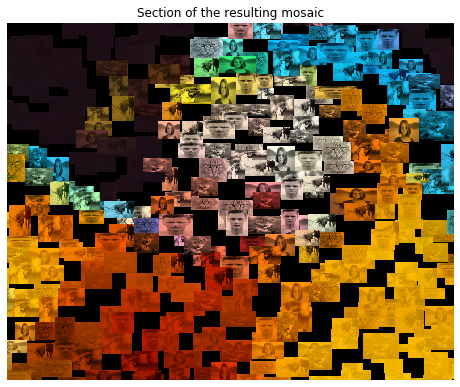

In [163]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[500:1300, 2000:3000, :])
plt.title("Section of the resulting mosaic")